In [48]:
# Import essential libraries
import pandas as pd
import numpy as np

In [49]:
#Data Import and Initial Exploration
# Read the primary datasets
final_data = pd.read_csv(r"C:\Users\DELL\Downloads\Final_data.csv")
south_climate = pd.read_csv(r"C:\Users\DELL\Downloads\south_india_disease_climate.csv")
dengue_cases = pd.read_csv(r"C:\Users\DELL\Downloads\dengue_cases_in_india.csv")
climate = pd.read_csv(r"C:\Users\DELL\Downloads\climate.csv")

In [94]:
# Displaying the first few rows of the combined dataset
final_data.head()

,week_of_outbreak,state_ut,district,disease,cases,deaths,day,mon,year,latitude,longitude,preci,lai,temp,high_risk
0,1st week,Meghalaya,East Jaintia Hills,Acute Diarrhoeal Disease,160.0,NaN,2,1,2022,25.251576,92.484050,0.020354,34.5,291.533333,1
1,2nd week,Maharashtra,Gadchiroli,Malaria,7.0,2.0,10,1,2022,19.759070,80.162281,0.007479,9.0,299.970000,0
2,3rd week,Tamil Nadu,Pudukottai,Acute Diarrhoeal Disease,8.0,NaN,18,1,2022,10.382651,78.819126,0.107413,12.0,300.766667,0
3,3rd week,Gujarat,Patan,Acute Diarrhoeal Disease,7.0,NaN,11,1,2022,23.774057,71.683735,0.065094,9.0,299.080000,0
4,3rd week,Kerala,Ernakulam,Acute Diarrhoeal Disease,14.0,NaN,24,12,2021,9.984080,76.274146,0.041256,33.0,303.028000,0


In [76]:
#Data Quality Checks and Cleaning
# Checking for missing values across datasets
print("Final Data Missing Values:\n", final_data.isnull().sum())
print("\nSouth Climate Data Missing Values:\n", south_climate.isnull().sum())

Final Data Missing Values:
 week_of_outbreak       0
state_ut               0
district               0
disease                0
cases                  0
deaths              4290
day                    0
mon                    0
year                   0
latitude               0
longitude              0
rainfall               0
lai                    0
temp                   0
high_risk              0
cluster                0
risk_index             0
risk_level             0
dtype: int64

South Climate Data Missing Values:
 State        0
Year         0
Cases       20
Deaths      20
Rainfall    55
Temp        55
Humidity    55
Disease      0
dtype: int64


In [77]:
# Removing duplicates
final_data.drop_duplicates(inplace=True)

In [78]:
# Convert data types e.g., ensure year is integer
if final_data['year'].dtype != int:
    final_data['year'] = final_data['year'].astype(int)

In [79]:
# Strip whitespace and lowercase all column names
final_data.columns = final_data.columns.str.strip().str.lower()
print(final_data.columns.tolist())

['week_of_outbreak', 'state_ut', 'district', 'disease', 'cases', 'deaths', 'day', 'mon', 'year', 'latitude', 'longitude', 'rainfall', 'lai', 'temp', 'high_risk', 'cluster', 'risk_index', 'risk_level']


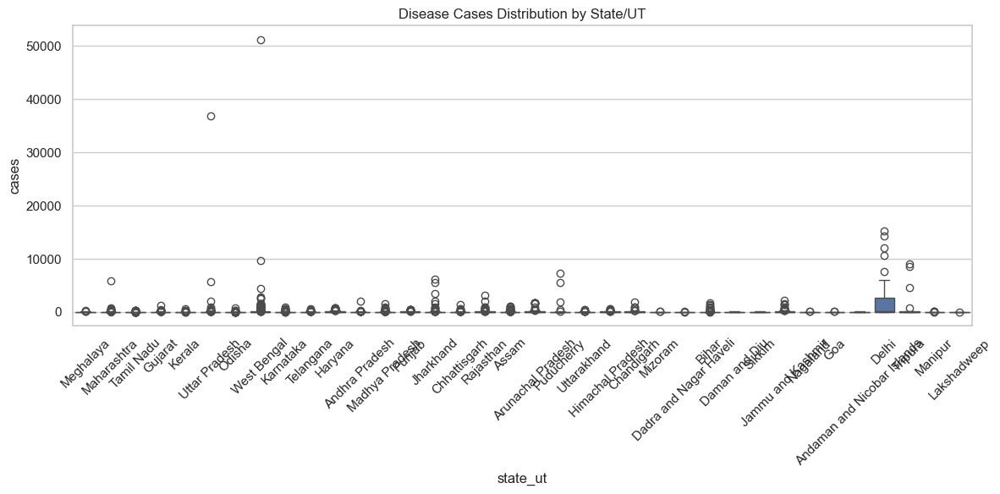

In [80]:
# Visualize disease case distribution across Indian states using a boxplot
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load and clean column names
final_data = pd.read_csv(r'C:\Users\DELL\Downloads\Final_data.csv')
final_data.columns = final_data.columns.str.strip().str.lower()

# Convert 'cases' to numeric
final_data['cases'] = pd.to_numeric(final_data['cases'], errors='coerce')

# Plot: Distribution of disease cases by state_ut
plt.figure(figsize=(12, 6))
sns.boxplot(x='state_ut', y='cases', data=final_data)
plt.title('Disease Cases Distribution by State/UT')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

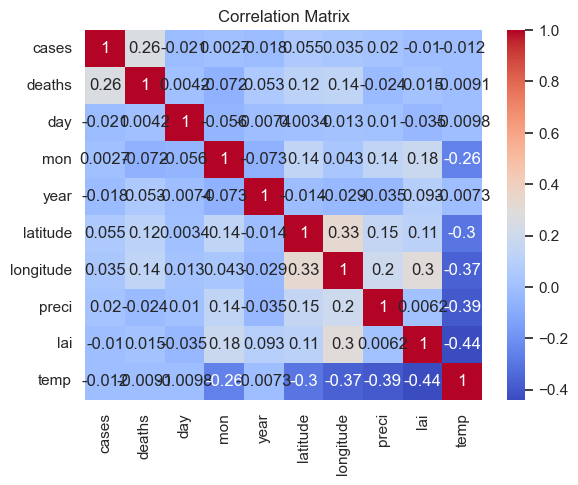

In [81]:
# Correlation heatmap
corr = final_data.select_dtypes(include=[np.number]).corr()
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


In [82]:
final_data.columns = final_data.columns.str.strip().str.lower()
import geopandas as gpd
import pandas as pd
import folium

# Load outbreak data
final_data = pd.read_csv(r'C:\Users\DELL\Downloads\Final_data.csv')
final_data.columns = final_data.columns.str.strip().str.lower()

# Load Tamil Nadu district boundaries
tamil_nadu = gpd.read_file(r'C:\Users\DELL\Downloads\tamil-nadu.geojson')

# Aggregate total cases by district
district_data = final_data.groupby('district').agg({'cases': 'sum'}).reset_index()

# Standardize GeoJSON column name if needed
tamil_nadu.columns = tamil_nadu.columns.str.strip().str.lower()

# Merge on matching district column
tamil_nadu = tamil_nadu.merge(district_data, left_on='district', right_on='district', how='left')

In [83]:
print(tamil_nadu.columns.tolist())

['district', 'st_code', 'dt_code', 'year', 'st_nm', 'geometry', 'cases']


In [84]:
# Standardize column names
tamil_nadu.columns = tamil_nadu.columns.str.strip().str.lower()

In [87]:
# Convert 'cases' column to numeric, coercing invalid entries to NaN
tamil_nadu['cases'] = pd.to_numeric(tamil_nadu['cases'], errors='coerce')

In [88]:
# Remove rows with missing 'cases' values to ensure clean analysis
tamil_nadu_clean = tamil_nadu.dropna(subset=['cases'])

In [90]:
# Create Folium map centered on Tamil Nadu
import folium

m = folium.Map(location=[11, 78], zoom_start=7)

# Choropleth map
folium.Choropleth(
    geo_data=tamil_nadu_clean,
    data=tamil_nadu_clean,
    columns=['district', 'cases'],
    key_on='feature.properties.district',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Disease Cases'
).add_to(m)

m

In [91]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix

# Load and clean dataset
final_data = pd.read_csv(r'C:\Users\DELL\Downloads\Final_data.csv')
final_data.columns = final_data.columns.str.strip().str.lower()

# Convert 'cases' to numeric
final_data['cases'] = pd.to_numeric(final_data['cases'], errors='coerce')

# Drop rows with missing 'cases'
final_data = final_data.dropna(subset=['cases'])

# Create high-risk label: cases above median
final_data['high_risk'] = (final_data['cases'] > final_data['cases'].median()).astype(int)

# Check available feature columns
print(final_data.columns.tolist())

['week_of_outbreak', 'state_ut', 'district', 'disease', 'cases', 'deaths', 'day', 'mon', 'year', 'latitude', 'longitude', 'preci', 'lai', 'temp', 'high_risk']


In [92]:
# Train and evaluate a Random Forest classifier to predict high-risk outbreaks using climate features

# Select valid features
features = ['temp', 'preci', 'lai']
X = final_data[features]
y = final_data['high_risk']

# Drop rows with missing feature values
X = X.dropna()
y = y.loc[X.index]

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42)

# Train classifier
clf = RandomForestClassifier(random_state=42)
clf.fit(X_train, y_train)

# Predict and evaluate
y_pred = clf.predict(X_test)
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("\nClassification Report:\n", classification_report(y_test, y_pred))

Confusion Matrix:
 [[441 318]
 [339 401]]

Classification Report:
               precision    recall  f1-score   support

           0       0.57      0.58      0.57       759
           1       0.56      0.54      0.55       740

    accuracy                           0.56      1499
   macro avg       0.56      0.56      0.56      1499
weighted avg       0.56      0.56      0.56      1499



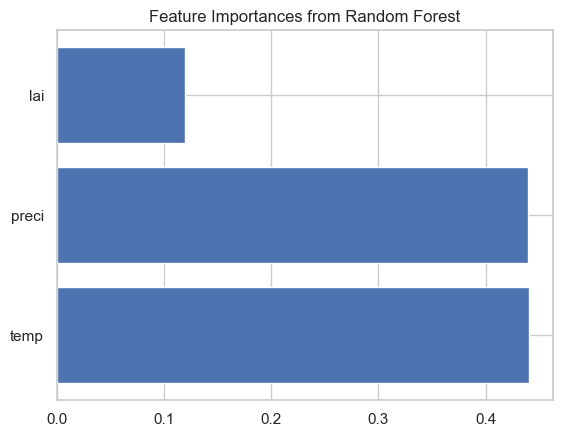

In [93]:
#Model Evaluation and Visualization
# Feature importance plot
importances = clf.feature_importances_
feature_list = list(X.columns)
plt.barh(feature_list, importances)
plt.title("Feature Importances from Random Forest")
plt.show()

In [95]:
# Forecast dengue cases for the next 12 months using SARIMA time-series modeling
from statsmodels.tsa.statespace.sarimax import SARIMAX
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Group dengue cases by year and month
ts_data = final_data.groupby(['year', 'mon'])['cases'].sum().reset_index()

# Rename 'mon' to 'month' for datetime conversion
ts_data = ts_data.rename(columns={'mon': 'month'})

# Create a datetime column
ts_data['date'] = pd.to_datetime(ts_data[['year', 'month']].assign(day=1))

# Set date as index
ts_data.set_index('date', inplace=True)

# Ensure 'cases' is numeric
ts_data['cases'] = pd.to_numeric(ts_data['cases'], errors='coerce')

# Fit SARIMA model
model = SARIMAX(ts_data['cases'], order=(1,1,1), seasonal_order=(1,1,1,12))
results = model.fit(disp=False)

# Forecast next 12 months
forecast = results.get_forecast(steps=12)
forecast_mean = forecast.predicted_mean.clip(lower=0).round().astype(int)
forecast_ci = forecast.conf_int()

# Display forecast
print("Forecasted Dengue Cases:\n", forecast_mean)

E:\Anaconda\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
E:\Anaconda\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)


Forecasted Dengue Cases:
 2022-07-01    6146
2022-08-01    3362
2022-09-01    7562
2022-10-01    1068
2022-11-01      43
2022-12-01       0
2023-01-01       0
2023-02-01       0
2023-03-01       0
2023-04-01       0
2023-05-01    2471
2023-06-01    1581
Freq: MS, Name: predicted_mean, dtype: int64


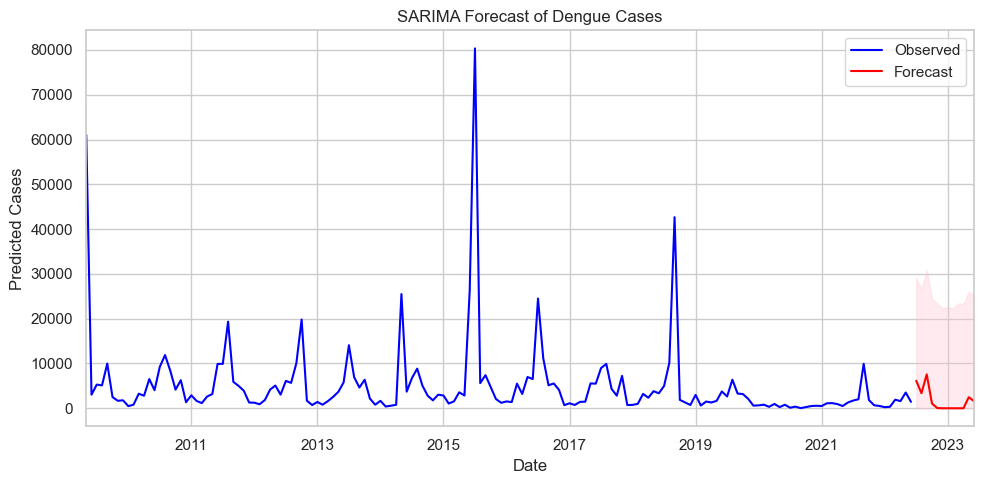

In [96]:
#Plot forecast
plt.figure(figsize=(10, 5))
ts_data['cases'].plot(label='Observed', color='blue')
forecast_mean.plot(label='Forecast', color='red')
plt.fill_between(forecast_ci.index,
                 forecast_ci.iloc[:, 0].clip(lower=0),
                 forecast_ci.iloc[:, 1].clip(lower=0),
                 color='pink', alpha=0.3)
plt.title('SARIMA Forecast of Dengue Cases')
plt.xlabel('Date')
plt.ylabel('Predicted Cases')
plt.legend()
plt.tight_layout()
plt.show()

In [97]:
# Perform spatial clustering of outbreak locations using DBSCAN and summarize cluster distribution
from sklearn.cluster import DBSCAN
import numpy as np
import pandas as pd
import folium

# Ensure latitude and longitude are numeric
final_data['latitude'] = pd.to_numeric(final_data['latitude'], errors='coerce')
final_data['longitude'] = pd.to_numeric(final_data['longitude'], errors='coerce')

# Drop rows with missing coordinates
coords = final_data[['latitude', 'longitude']].dropna()

# Fit DBSCAN model
db = DBSCAN(eps=0.5, min_samples=5).fit(coords)

# Assign cluster labels
final_data['cluster'] = np.nan
final_data.loc[coords.index, 'cluster'] = db.labels_

# Summary of clusters
cluster_counts = final_data['cluster'].value_counts().sort_index()
print("Cluster Summary:\n", cluster_counts)

Cluster Summary:
 cluster
-1.0      109
 0.0       40
 1.0       59
 2.0      213
 3.0        5
         ... 
 210.0      8
 211.0      7
 212.0      6
 213.0      6
 214.0      5
Name: count, Length: 216, dtype: int64


In [98]:
# Create base map centered on South India
m = folium.Map(location=[11.5, 78.5], zoom_start=6)

# Add outbreak points colored by cluster
for _, row in final_data.dropna(subset=['cluster']).iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=4,
        color='blue' if row['cluster'] == -1 else 'red',
        fill=True,
        fill_opacity=0.6,
        popup=f"Cluster: {int(row['cluster'])}, Cases: {row['cases']}"
    ).add_to(m)

m

<Figure size 640x480 with 0 Axes>

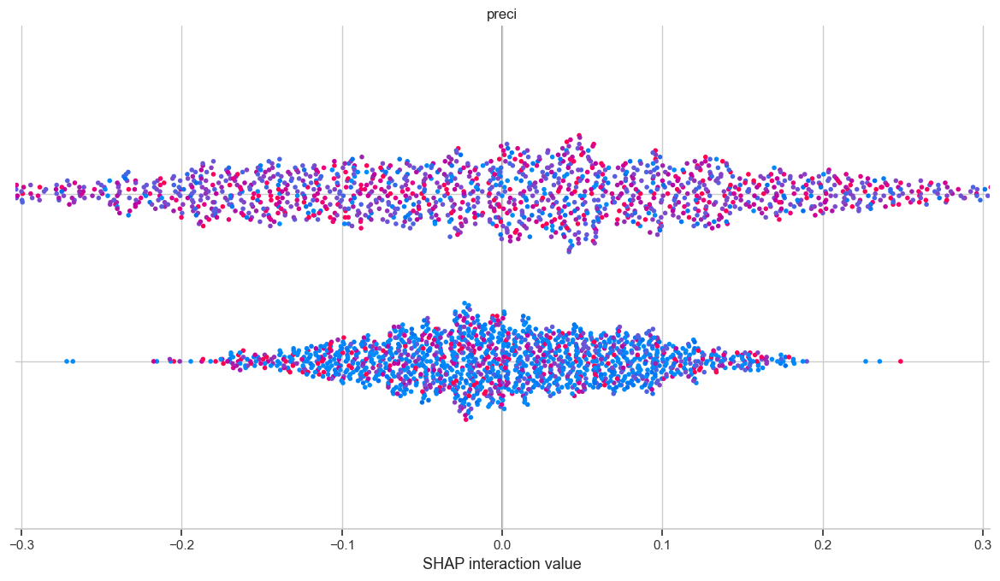

In [99]:
# Generate and visualize global feature importance using SHAP summary plot for class 1 predictions
import shap
import matplotlib.pyplot as plt

# Initialize SHAP explainer
explainer = shap.TreeExplainer(clf)
shap_values = explainer.shap_values(X_test)

# Use mean absolute SHAP values for global importance
shap.summary_plot(shap_values, X_test, plot_type="bar")

C:\Users\DELL\AppData\Local\Temp\ipykernel_6768\3769957365.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='disease', y='rainfall', data=plot_data, palette='Set2')


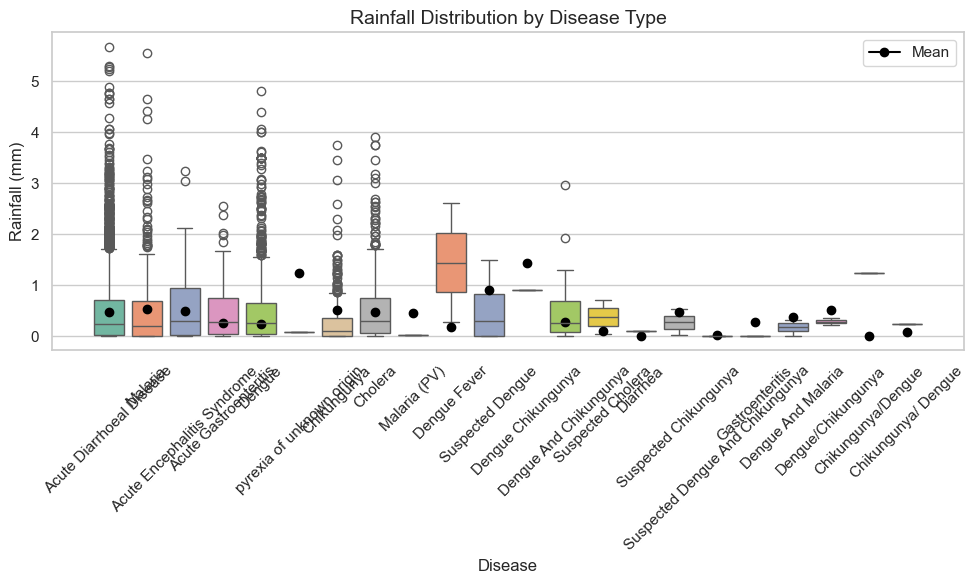

In [100]:
# Visualize rainfall distribution across disease types with boxplots and overlay mean rainfall markers
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Set plot style
sns.set(style="whitegrid")

# Rename 'preci' to 'rainfall' for clarity
final_data = final_data.rename(columns={'preci': 'rainfall'})

# Ensure 'rainfall' is numeric
final_data['rainfall'] = pd.to_numeric(final_data['rainfall'], errors='coerce')

# Drop rows with missing values
plot_data = final_data.dropna(subset=['disease', 'rainfall'])

# Create boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x='disease', y='rainfall', data=plot_data, palette='Set2')

# Overlay mean rainfall per disease
mean_rainfall = plot_data.groupby('disease')['rainfall'].mean()
for i, disease in enumerate(mean_rainfall.index):
    plt.plot(i, mean_rainfall[disease], marker='o', color='black', label='Mean' if i == 0 else "")

# Customize plot
plt.title('Rainfall Distribution by Disease Type', fontsize=14)
plt.xlabel('Disease', fontsize=12)
plt.ylabel('Rainfall (mm)', fontsize=12)
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

In [101]:
# Calculate a weighted risk index using ranked climate and case data to identify top outbreak zones
import pandas as pd

# Ensure all inputs are numeric
final_data['rainfall'] = pd.to_numeric(final_data['rainfall'], errors='coerce')
final_data['temp'] = pd.to_numeric(final_data['temp'], errors='coerce')
final_data['cases'] = pd.to_numeric(final_data['cases'], errors='coerce')

# Drop rows with missing values in key columns
final_data = final_data.dropna(subset=['rainfall', 'temp', 'cases'])

# Compute normalized ranks (0 to 1)
rainfall_rank = final_data['rainfall'].rank(pct=True)
temp_rank = final_data['temp'].rank(pct=True)
cases_rank = final_data['cases'].rank(pct=True)

# Weighted risk index
final_data['risk_index'] = (
    0.4 * rainfall_rank +
    0.3 * temp_rank +
    0.3 * cases_rank
) * 100  # Optional: scale to 0–100

# Preview top risk zones
print(final_data[['district', 'risk_index']].sort_values(by='risk_index', ascending=False).head())

            district  risk_index
4445      Aurangabad   90.561231
957   Kanpur (Dehat)   89.271661
3982        Kalburgi   89.143650
7389         Burdwan   88.189557
5522          Mandla   87.724177


In [102]:
# Calculate and categorize a composite outbreak risk index using ranked environmental and epidemiological features
import pandas as pd
import folium

# Renaming 'preci' to 'rainfall'
final_data = final_data.rename(columns={'preci': 'rainfall'})

# Define all possible features
all_features = ['rainfall', 'temp', 'cases', 'humidity', 'population_density', 'lai', 'latitude', 'longitude']

# Filter to only existing columns
available_features = [col for col in all_features if col in final_data.columns]

# Ensure numeric types for available features
for col in available_features:
    final_data[col] = pd.to_numeric(final_data[col], errors='coerce')

# Drop rows with missing values in available features
final_data = final_data.dropna(subset=available_features)

# Define weights for risk index (adjusted to available features)
weights = {
    'rainfall': 0.25,
    'temp': 0.20,
    'cases': 0.20,
    'humidity': 0.10,
    'population_density': 0.15,
    'lai': 0.10
}

# Normalize weights to sum to 1 for available features
active_weights = {k: v for k, v in weights.items() if k in final_data.columns}
total_weight = sum(active_weights.values())
normalized_weights = {k: v / total_weight for k, v in active_weights.items()}

# Compute risk index
final_data['risk_index'] = sum(
    normalized_weights[col] * final_data[col].rank(pct=True)
    for col in normalized_weights
) * 100  # Scale to 0–100

# Bin into categories
final_data['risk_level'] = pd.cut(
    final_data['risk_index'],
    bins=[0, 33, 66, 100],
    labels=['Low', 'Medium', 'High']
)

# Summary
print(final_data[['district', 'risk_index', 'risk_level']].sort_values(by='risk_index', ascending=False).head())

                district  risk_index risk_level
4445          Aurangabad   83.975984       High
4501           Ernakulam   83.859239       High
4788            Dhamtari   80.752724       High
6486             Lunglei   80.385813       High
4161  Thiruvananthapuram   80.125639       High


In [103]:
# Visualize clustered outbreak risk levels across South India using Folium with interactive circle markers
import folium
from folium.plugins import MarkerCluster

# Create base map centered on South India
m = folium.Map(location=[11.5, 78.5], zoom_start=6, tiles='CartoDB positron')

# Color mapping
color_map = {'Low': 'green', 'Medium': 'orange', 'High': 'red'}

# Initialize marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Add circle markers to cluster
for _, row in final_data.dropna(subset=['latitude', 'longitude', 'risk_level']).iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5 + (row['risk_index'] / 20),  # scale radius by risk index
        color=color_map.get(row['risk_level'], 'gray'),
        fill=True,
        fill_opacity=0.8,
        popup=folium.Popup(
            f"<b>District:</b> {row['district']}<br>"
            f"<b>Risk Level:</b> {row['risk_level']}<br>"
            f"<b>Risk Index:</b> {row['risk_index']:.1f}",
            max_width=250
        )
    ).add_to(marker_cluster)

m